<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1I8kDikouqpH4hf7JBiSYAeNT2IO52T-T" width=600 height=480/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Generative adversarial networks</b></h3>



В этом домашнем задании вы обучите GAN генерировать лица людей и посмотрите на то, как можно оценивать качество генерации

In [1]:
import os
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set(style='darkgrid', font_scale=1.2)

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## Часть 1. Подготовка данных (1 балл)

В качестве обучающей выборки возьмем часть датасета [Flickr Faces](https://github.com/NVlabs/ffhq-dataset), который содержит изображения лиц людей в высоком разрешении (1024х1024). Оригинальный датасет очень большой, поэтому мы возьмем его часть. Скачать датасет можно [здесь](https://www.kaggle.com/datasets/tommykamaz/faces-dataset-small?resource=download-directory) и  [здесь](https://drive.google.com/drive/folders/14H7LQWzd09SaM11oLfGtd455sWH2rmRW?usp=share_link)

Давайте загрузим наши изображения. Напишите функцию, которая строит DataLoader для изображений, при этом меняя их размер до нужного значения (размер 1024 слишком большой, поэтому мы рекомендуем взять размер 128 либо немного больше)

In [2]:
#!gdown 1inyvLrN5wKBGCxQ4znMKBc64uL4uP_2x

In [3]:
#!unzip archive.zip

In [4]:
DATA_DIR = '../input/faces-dataset'

In [5]:
def get_dataloader(image_size, batch_size):
  """
  Builds dataloader for training data.
  Use tt.Compose and tt.Resize for transformations
  :param image_size: height and wdith of the image
  :param batch_size: batch_size of the dataloader
  :returns: DataLoader object
  """
  train_ds = ImageFolder(DATA_DIR, transform=tt.Compose([
    tt.Resize(image_size),
    tt.CenterCrop(image_size),
    tt.ToTensor()]))

  return DataLoader(train_ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)

In [6]:
image_size = 64
batch_size = 128
train_loader  = get_dataloader(image_size, batch_size)

In [7]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(images.detach()[:nmax], nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

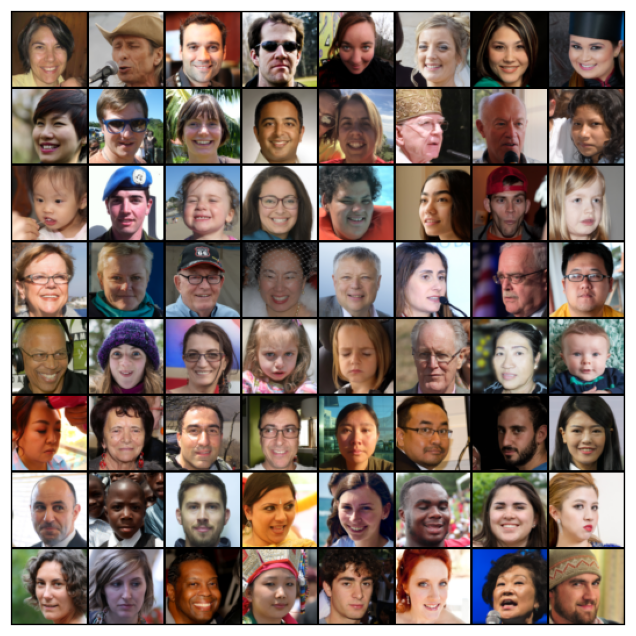

In [8]:
show_batch(train_loader)

In [9]:
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device

    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl:
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [10]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

device(type='cuda')

In [11]:
train_loader = DeviceDataLoader(train_loader, device)

## Часть 2. Построение и обучение модели (2 балла)

Сконструируйте генератор и дискриминатор. Помните, что:
* дискриминатор принимает на вход изображение (тензор размера `3 x image_size x image_size`) и выдает вероятность того, что изображение настоящее (тензор размера 1)

* генератор принимает на вход тензор шумов размера `latent_size x 1 x 1` и генерирует изображение размера `3 x image_size x image_size`

In [12]:
!pip install torchsummary
from torchsummary import summary

In [13]:
discriminator = nn.Sequential(
    # in: 3 x 64 x 64

    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())

discriminator = to_device(discriminator, device)

In [14]:
summary(discriminator,(3, image_size, image_size))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,072
       BatchNorm2d-2           [-1, 64, 32, 32]             128
         LeakyReLU-3           [-1, 64, 32, 32]               0
            Conv2d-4          [-1, 128, 16, 16]         131,072
       BatchNorm2d-5          [-1, 128, 16, 16]             256
         LeakyReLU-6          [-1, 128, 16, 16]               0
            Conv2d-7            [-1, 256, 8, 8]         524,288
       BatchNorm2d-8            [-1, 256, 8, 8]             512
         LeakyReLU-9            [-1, 256, 8, 8]               0
           Conv2d-10            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-11            [-1, 512, 4, 4]           1,024
        LeakyReLU-12            [-1, 512, 4, 4]               0
           Conv2d-13              [-1, 1, 1, 1]           8,192
          Flatten-14                   

In [15]:
latent_size = 128

In [16]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64
)
generator = to_device(generator, device)

In [17]:
summary(generator, (latent_size, 1, 1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]       1,048,576
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
             Tanh-14            [-1, 3,

Перейдем теперь к обучению нашего GANа. Алгоритм обучения следующий:
1. Учим дискриминатор:
  * берем реальные изображения и присваиваем им метку 1
  * генерируем изображения генератором и присваиваем им метку 0
  * обучаем классификатор на два класса

2. Учим генератор:
  * генерируем изображения генератором и присваиваем им метку 0
  * предсказываем дискриминаторором, реальное это изображение или нет


В качестве функции потерь берем бинарную кросс-энтропию

In [18]:
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

In [19]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

In [20]:
def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(fake_images, os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))

In [21]:
def fit(model, criterion, epochs, lr, start_idx=1):
    model["discriminator"].train()
    model["generator"].train()
    torch.cuda.empty_cache()

    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []

    # Create optimizers
    optimizer = {
        "discriminator": torch.optim.Adam(model["discriminator"].parameters(),
                                          lr=lr, betas=(0.5, 0.999)),
        "generator": torch.optim.Adam(model["generator"].parameters(),
                                      lr=lr, betas=(0.5, 0.999))
    }

    for epoch in tqdm(range(epochs)):
        loss_d_per_epoch = []
        loss_g_per_epoch = []
        real_score_per_epoch = []
        fake_score_per_epoch = []
        for real_images, _ in tqdm(train_loader):
            # Train discriminator
            # Clear discriminator gradients
            optimizer["discriminator"].zero_grad()

            # Pass real images through discriminator
            real_preds = model["discriminator"](real_images)
            real_targets = torch.ones(real_images.size(0), 1, device=device)
            real_loss = criterion["discriminator"](real_preds, real_targets)
            cur_real_score = torch.mean(real_preds).item()

            # Generate fake images
            latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
            fake_images = model["generator"](latent)

            # Pass fake images through discriminator
            fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
            fake_preds = model["discriminator"](fake_images)
            fake_loss = criterion["discriminator"](fake_preds, fake_targets)
            cur_fake_score = torch.mean(fake_preds).item()

            real_score_per_epoch.append(cur_real_score)
            fake_score_per_epoch.append(cur_fake_score)

            # Update discriminator weights
            loss_d = real_loss + fake_loss
            loss_d.backward()
            optimizer["discriminator"].step()
            loss_d_per_epoch.append(loss_d.item())


            # Train generator
            # Clear generator gradients
            optimizer["generator"].zero_grad()

            # Generate fake images
            latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
            fake_images = model["generator"](latent)

            # Try to fool the discriminator
            preds = model["discriminator"](fake_images)
            targets = torch.ones(batch_size, 1, device=device)
            loss_g = criterion["generator"](preds, targets)

            # Update generator weights
            loss_g.backward()
            optimizer["generator"].step()
            loss_g_per_epoch.append(loss_g.item())

        # Record losses & scores
        losses_g.append(np.mean(loss_g_per_epoch))
        losses_d.append(np.mean(loss_d_per_epoch))
        real_scores.append(np.mean(real_score_per_epoch))
        fake_scores.append(np.mean(fake_score_per_epoch))

        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs,
            losses_g[-1], losses_d[-1], real_scores[-1], fake_scores[-1]))

        # Пример генерации
        if epoch % 2 == 0:
          plt.figure(figsize=(12,12))
          plt.axis("off")
          plt.title("Generated Images")
          plt.imshow(np.transpose(make_grid(fake_images.to(device)[:16], padding=2, normalize=True).cpu(),(1,2,0)))
          plt.show()

        # Save generated images
        if epoch == epochs - 1:
          save_samples(epoch+start_idx, fixed_latent, show=False)

    return losses_g, losses_d, real_scores, fake_scores

In [22]:
lr = 0.0001
model = {
    "discriminator": discriminator,
    "generator": generator
}

criterion = {
    "discriminator": nn.BCELoss(),
    "generator": nn.BCELoss()
}
epochs = 80

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [1/80], loss_g: 9.0763, loss_d: 0.0511, real_score: 0.9868, fake_score: 0.0209


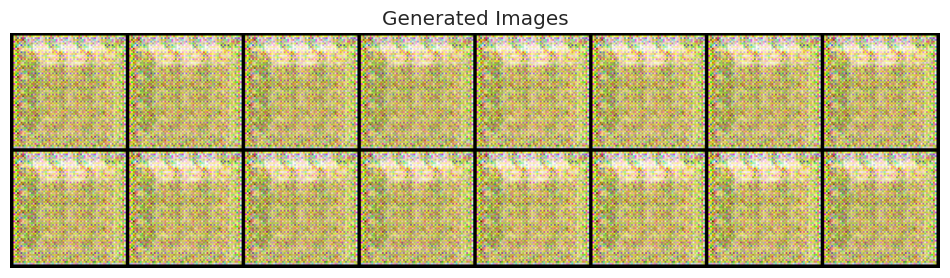

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [2/80], loss_g: 5.3748, loss_d: 0.2825, real_score: 0.9249, fake_score: 0.0678


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [3/80], loss_g: 4.6799, loss_d: 0.3127, real_score: 0.9074, fake_score: 0.0910


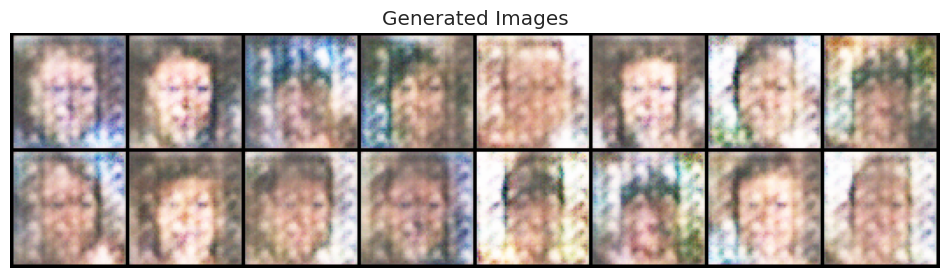

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [4/80], loss_g: 4.6357, loss_d: 0.2515, real_score: 0.9198, fake_score: 0.0785


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [5/80], loss_g: 4.7288, loss_d: 0.2419, real_score: 0.9206, fake_score: 0.0778


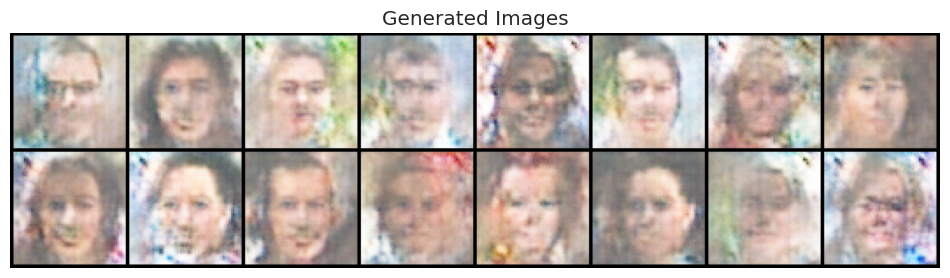

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [6/80], loss_g: 4.7012, loss_d: 0.2596, real_score: 0.9153, fake_score: 0.0836


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [7/80], loss_g: 4.6603, loss_d: 0.2436, real_score: 0.9237, fake_score: 0.0758


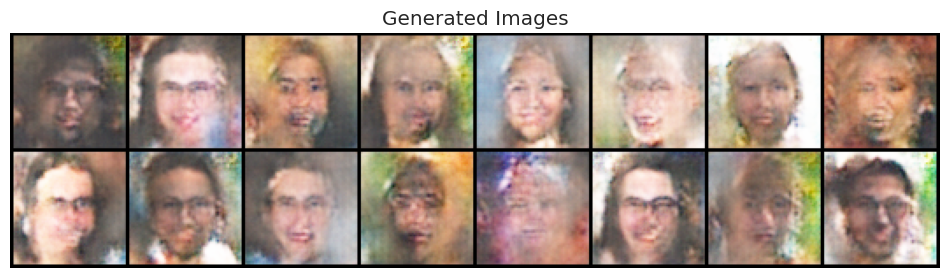

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [8/80], loss_g: 4.7791, loss_d: 0.2132, real_score: 0.9267, fake_score: 0.0724


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [9/80], loss_g: 4.8840, loss_d: 0.2462, real_score: 0.9237, fake_score: 0.0757


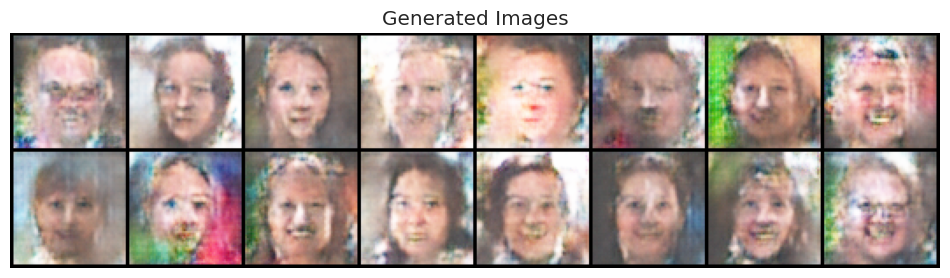

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [10/80], loss_g: 4.7731, loss_d: 0.2061, real_score: 0.9323, fake_score: 0.0668


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [11/80], loss_g: 4.8193, loss_d: 0.2064, real_score: 0.9371, fake_score: 0.0622


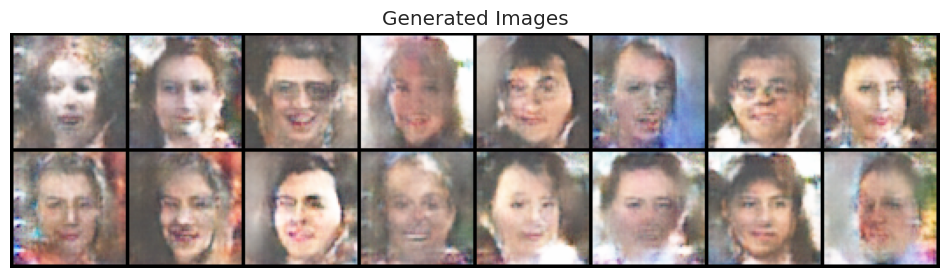

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [12/80], loss_g: 4.9183, loss_d: 0.2043, real_score: 0.9333, fake_score: 0.0663


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [13/80], loss_g: 5.2518, loss_d: 0.2031, real_score: 0.9364, fake_score: 0.0635


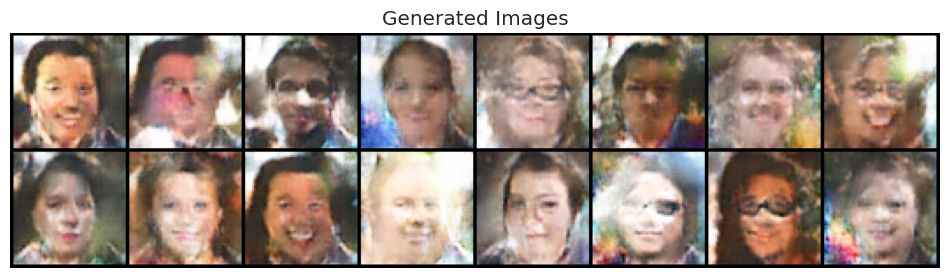

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [14/80], loss_g: 5.2953, loss_d: 0.1784, real_score: 0.9415, fake_score: 0.0579


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [15/80], loss_g: 5.3198, loss_d: 0.1785, real_score: 0.9447, fake_score: 0.0549


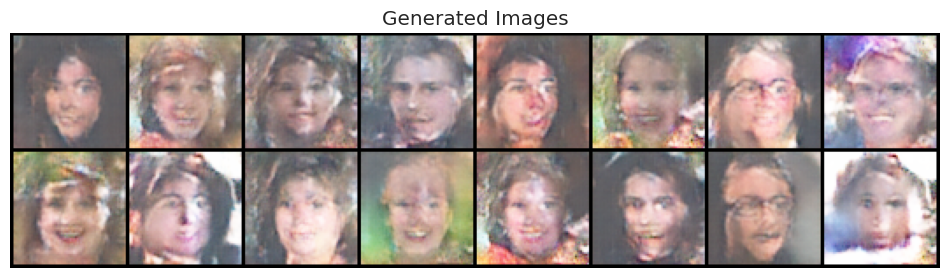

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [16/80], loss_g: 5.1538, loss_d: 0.1603, real_score: 0.9474, fake_score: 0.0526


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [17/80], loss_g: 5.3115, loss_d: 0.1630, real_score: 0.9474, fake_score: 0.0521


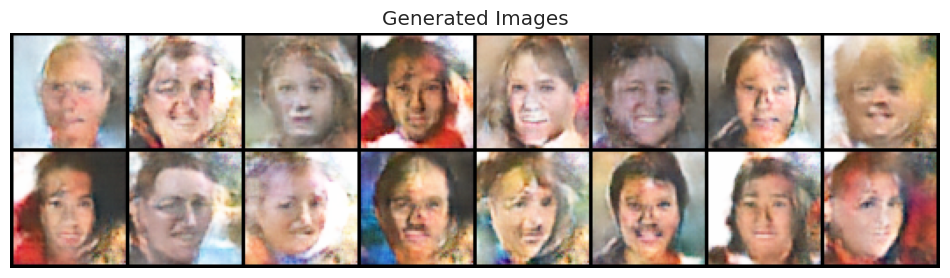

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [18/80], loss_g: 5.4125, loss_d: 0.2324, real_score: 0.9392, fake_score: 0.0607


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [19/80], loss_g: 5.3284, loss_d: 0.1406, real_score: 0.9506, fake_score: 0.0495


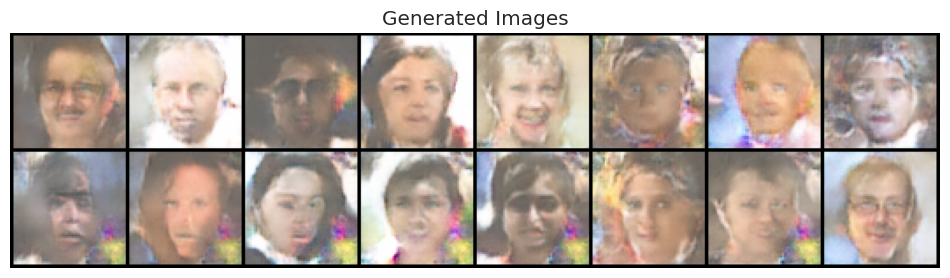

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [20/80], loss_g: 5.3465, loss_d: 0.2075, real_score: 0.9427, fake_score: 0.0562


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [21/80], loss_g: 5.3083, loss_d: 0.1648, real_score: 0.9487, fake_score: 0.0521


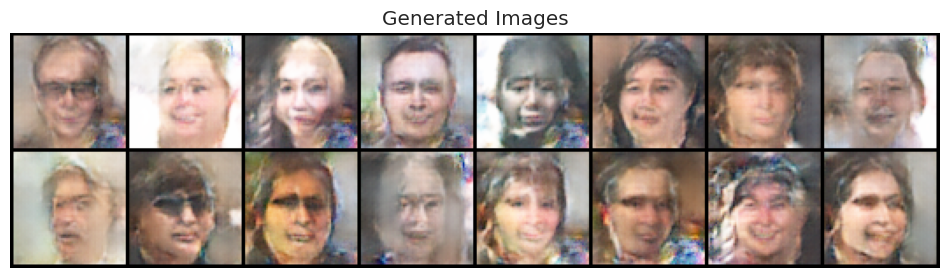

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [22/80], loss_g: 5.2471, loss_d: 0.1548, real_score: 0.9508, fake_score: 0.0488


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [23/80], loss_g: 5.4382, loss_d: 0.1744, real_score: 0.9450, fake_score: 0.0549


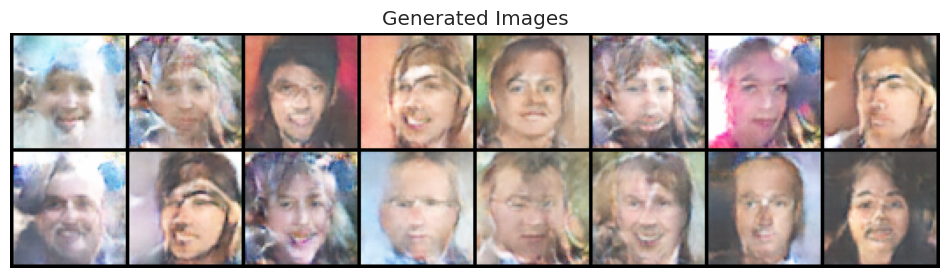

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [24/80], loss_g: 5.3547, loss_d: 0.1520, real_score: 0.9522, fake_score: 0.0478


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [25/80], loss_g: 5.3680, loss_d: 0.1659, real_score: 0.9488, fake_score: 0.0510


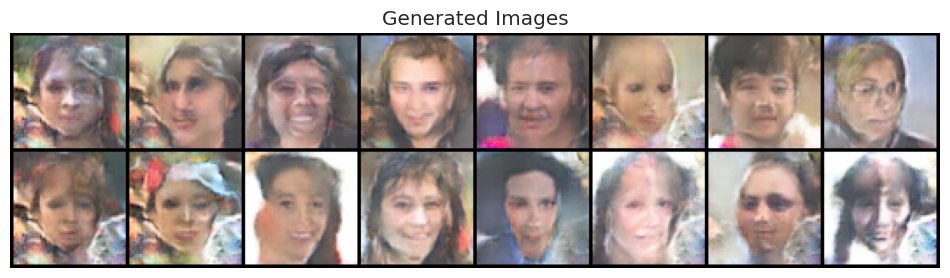

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [26/80], loss_g: 5.3247, loss_d: 0.1598, real_score: 0.9509, fake_score: 0.0490


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [27/80], loss_g: 5.3547, loss_d: 0.1978, real_score: 0.9428, fake_score: 0.0570


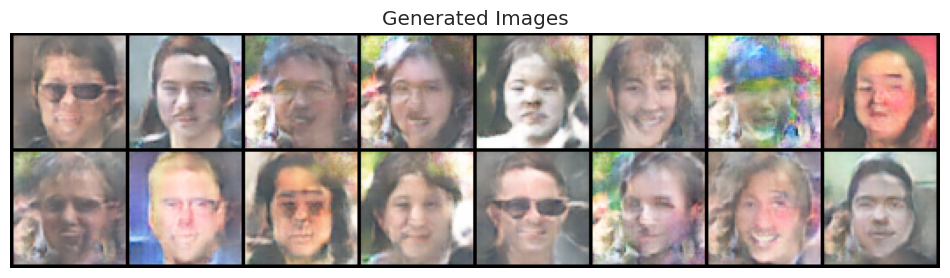

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [28/80], loss_g: 5.2805, loss_d: 0.1577, real_score: 0.9491, fake_score: 0.0508


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [29/80], loss_g: 5.6008, loss_d: 0.1473, real_score: 0.9529, fake_score: 0.0472


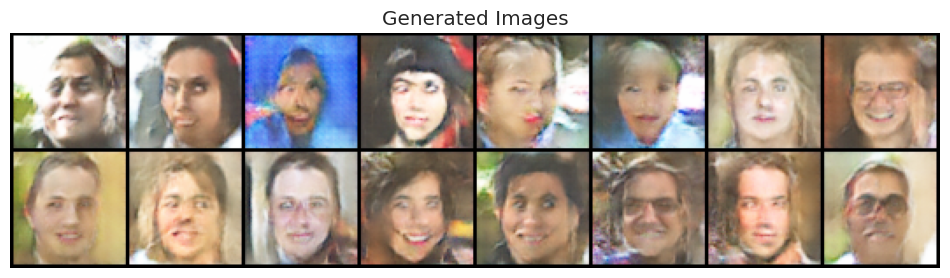

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [30/80], loss_g: 5.5032, loss_d: 0.1451, real_score: 0.9538, fake_score: 0.0460


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [31/80], loss_g: 5.5698, loss_d: 0.1250, real_score: 0.9562, fake_score: 0.0437


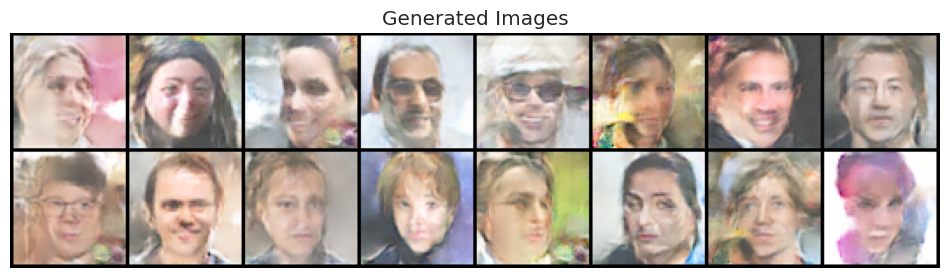

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [32/80], loss_g: 5.4434, loss_d: 0.1644, real_score: 0.9496, fake_score: 0.0502


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [33/80], loss_g: 5.4980, loss_d: 0.1628, real_score: 0.9512, fake_score: 0.0487


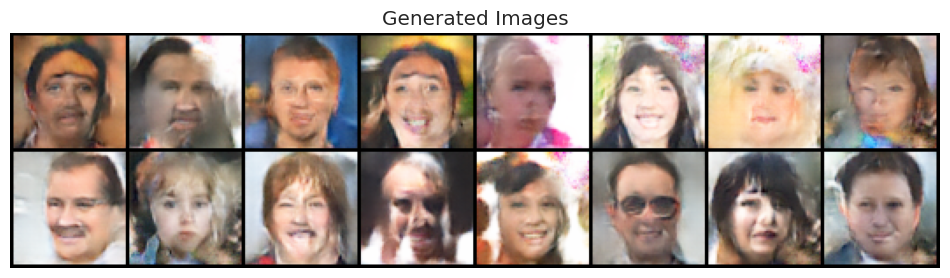

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [34/80], loss_g: 5.2610, loss_d: 0.1599, real_score: 0.9520, fake_score: 0.0479


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [35/80], loss_g: 5.6522, loss_d: 0.1447, real_score: 0.9557, fake_score: 0.0443


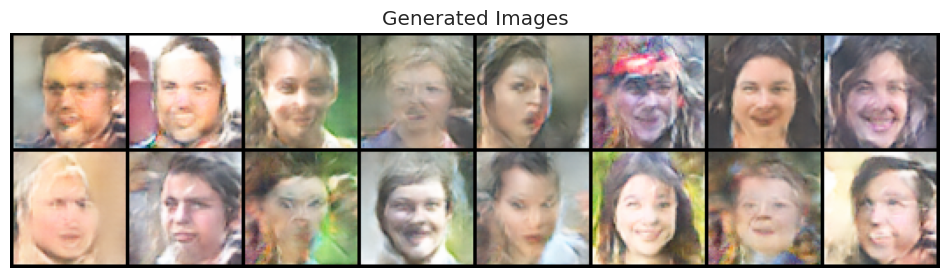

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [36/80], loss_g: 5.4750, loss_d: 0.1667, real_score: 0.9536, fake_score: 0.0466


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [37/80], loss_g: 5.4908, loss_d: 0.1519, real_score: 0.9532, fake_score: 0.0465


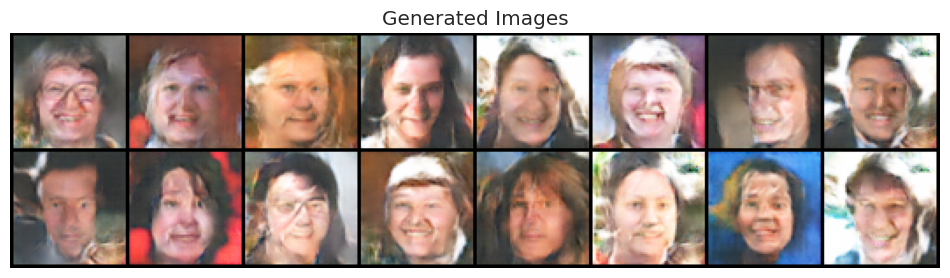

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [38/80], loss_g: 5.4876, loss_d: 0.1275, real_score: 0.9573, fake_score: 0.0426


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [39/80], loss_g: 5.3157, loss_d: 0.1958, real_score: 0.9474, fake_score: 0.0527


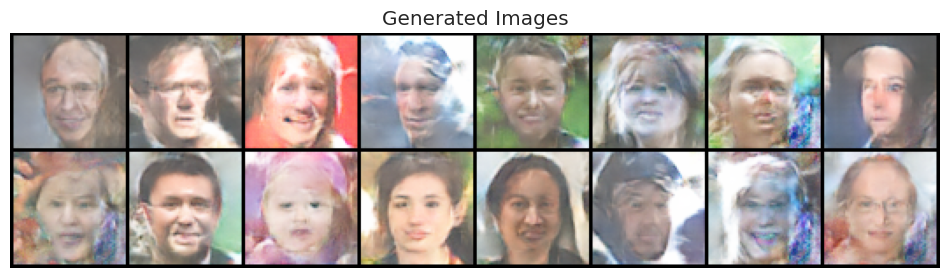

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [40/80], loss_g: 5.3722, loss_d: 0.1340, real_score: 0.9580, fake_score: 0.0419


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [41/80], loss_g: 5.5121, loss_d: 0.1847, real_score: 0.9536, fake_score: 0.0466


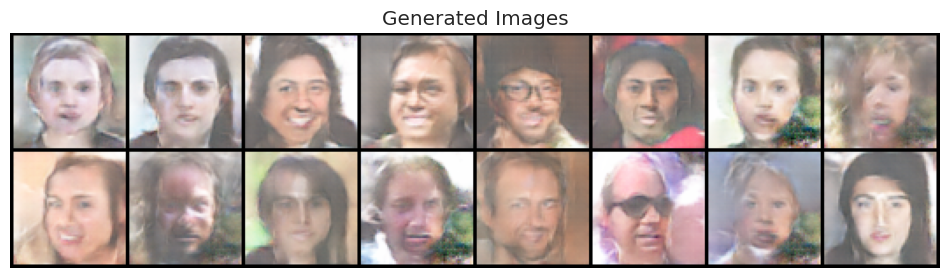

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [42/80], loss_g: 5.2115, loss_d: 0.1564, real_score: 0.9530, fake_score: 0.0469


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [43/80], loss_g: 5.4811, loss_d: 0.1522, real_score: 0.9524, fake_score: 0.0476


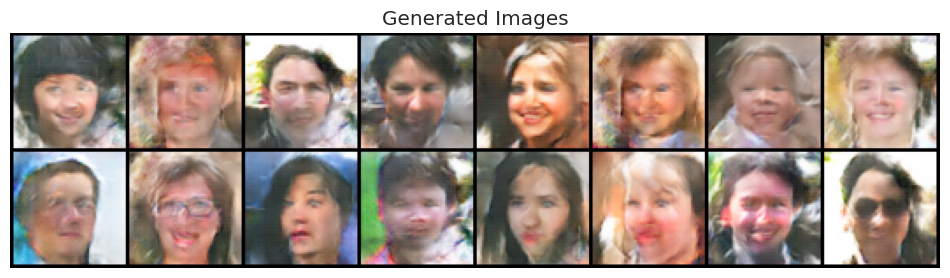

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [44/80], loss_g: 5.3728, loss_d: 0.1454, real_score: 0.9541, fake_score: 0.0459


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [45/80], loss_g: 5.4028, loss_d: 0.1417, real_score: 0.9550, fake_score: 0.0449


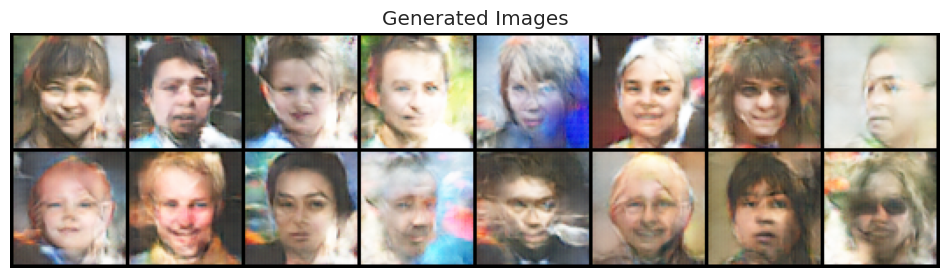

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [46/80], loss_g: 5.3548, loss_d: 0.1626, real_score: 0.9553, fake_score: 0.0448


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [47/80], loss_g: 5.2697, loss_d: 0.1587, real_score: 0.9519, fake_score: 0.0478


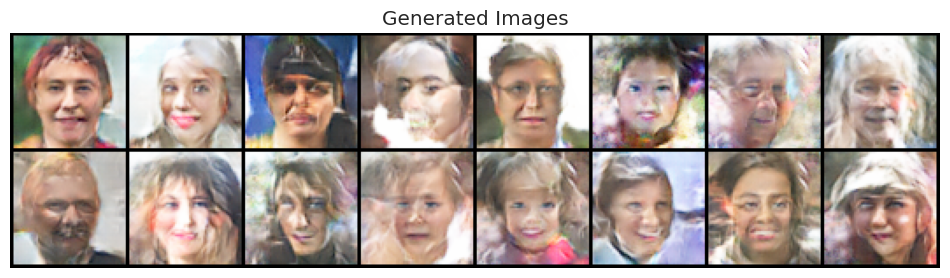

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [48/80], loss_g: 5.3246, loss_d: 0.1366, real_score: 0.9569, fake_score: 0.0432


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [49/80], loss_g: 5.3302, loss_d: 0.1636, real_score: 0.9509, fake_score: 0.0490


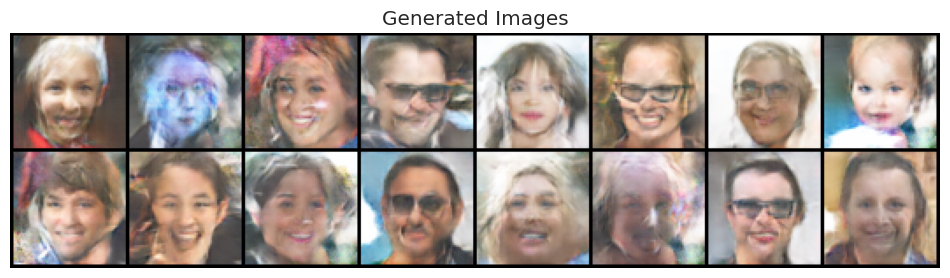

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [50/80], loss_g: 5.2162, loss_d: 0.1702, real_score: 0.9497, fake_score: 0.0500


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [51/80], loss_g: 5.3015, loss_d: 0.1375, real_score: 0.9562, fake_score: 0.0438


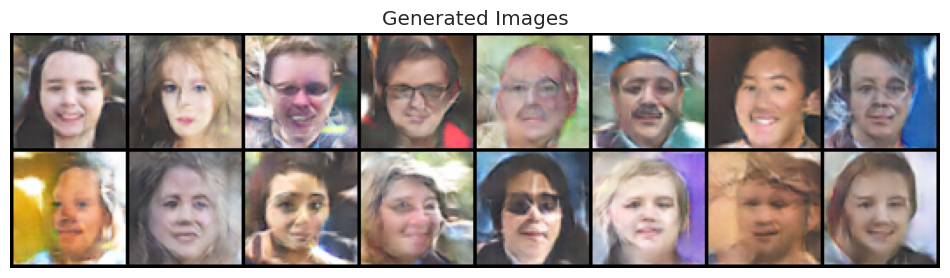

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [52/80], loss_g: 5.3545, loss_d: 0.1233, real_score: 0.9580, fake_score: 0.0418


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [53/80], loss_g: 5.1905, loss_d: 0.2456, real_score: 0.9378, fake_score: 0.0625


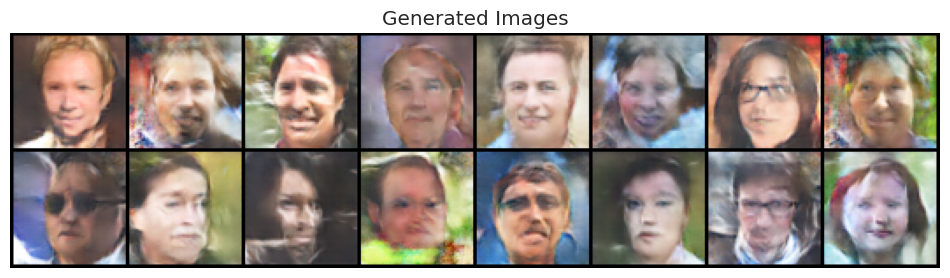

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [54/80], loss_g: 5.1365, loss_d: 0.1125, real_score: 0.9582, fake_score: 0.0418


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [55/80], loss_g: 5.2741, loss_d: 0.1701, real_score: 0.9487, fake_score: 0.0512


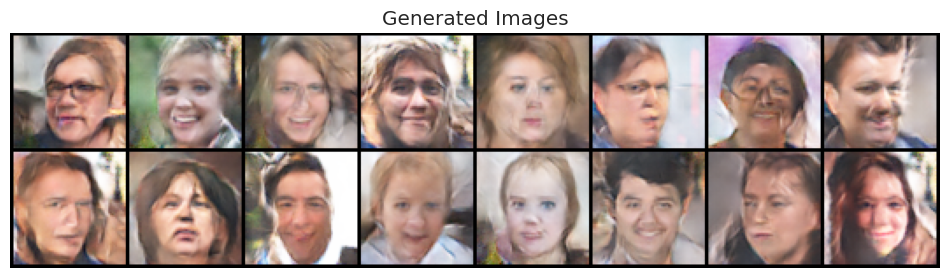

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [56/80], loss_g: 5.2256, loss_d: 0.1324, real_score: 0.9602, fake_score: 0.0397


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [57/80], loss_g: 5.2435, loss_d: 0.1905, real_score: 0.9478, fake_score: 0.0522


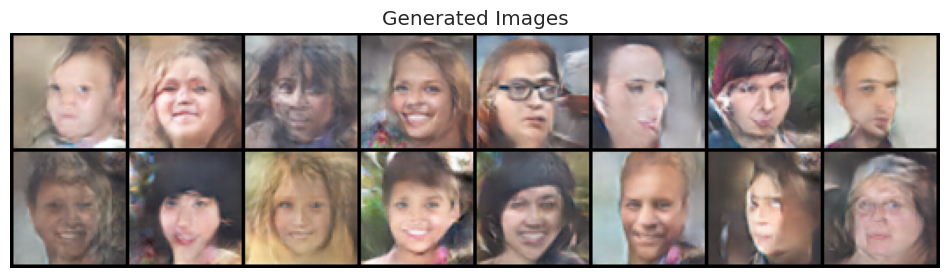

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [58/80], loss_g: 5.1633, loss_d: 0.1390, real_score: 0.9568, fake_score: 0.0429


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [59/80], loss_g: 5.2188, loss_d: 0.1635, real_score: 0.9546, fake_score: 0.0452


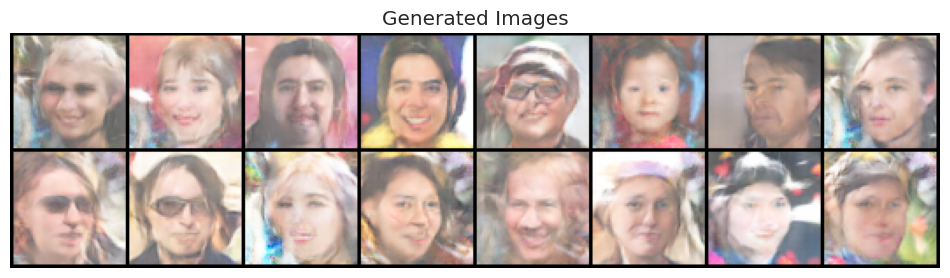

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [60/80], loss_g: 5.2165, loss_d: 0.1444, real_score: 0.9534, fake_score: 0.0470


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [61/80], loss_g: 5.2271, loss_d: 0.1937, real_score: 0.9449, fake_score: 0.0552


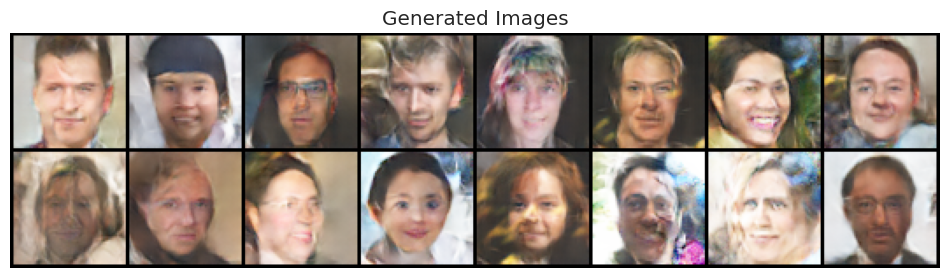

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [62/80], loss_g: 5.2135, loss_d: 0.1604, real_score: 0.9525, fake_score: 0.0474


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [63/80], loss_g: 5.1552, loss_d: 0.1291, real_score: 0.9591, fake_score: 0.0409


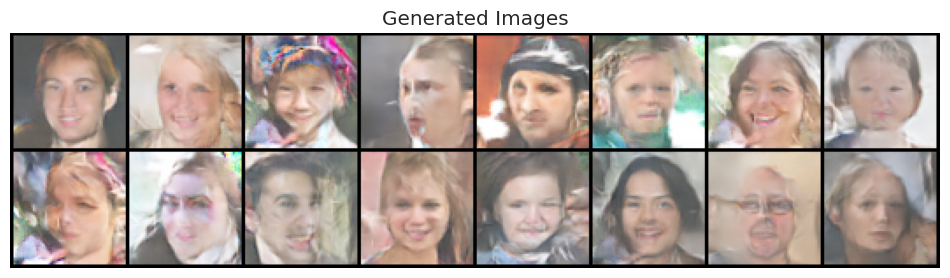

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [64/80], loss_g: 5.2634, loss_d: 0.1729, real_score: 0.9480, fake_score: 0.0519


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [65/80], loss_g: 5.1872, loss_d: 0.1389, real_score: 0.9560, fake_score: 0.0440


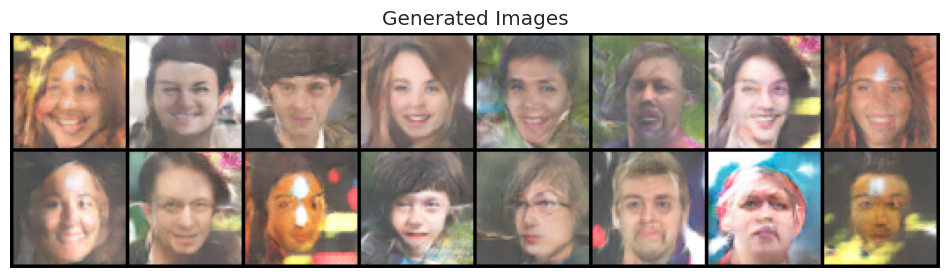

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [66/80], loss_g: 5.1495, loss_d: 0.1921, real_score: 0.9457, fake_score: 0.0541


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [67/80], loss_g: 5.0386, loss_d: 0.1729, real_score: 0.9477, fake_score: 0.0525


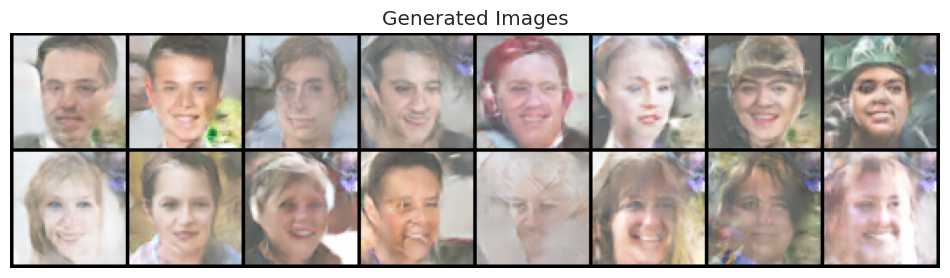

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [68/80], loss_g: 5.1886, loss_d: 0.1559, real_score: 0.9525, fake_score: 0.0471


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [69/80], loss_g: 5.2901, loss_d: 0.1175, real_score: 0.9590, fake_score: 0.0412


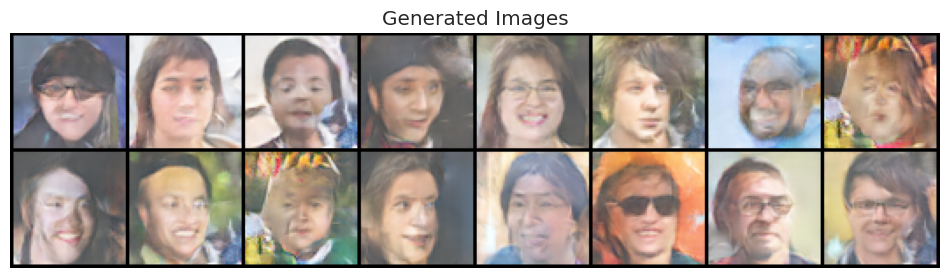

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [70/80], loss_g: 5.2997, loss_d: 0.1773, real_score: 0.9496, fake_score: 0.0503


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [71/80], loss_g: 5.1561, loss_d: 0.1688, real_score: 0.9542, fake_score: 0.0458


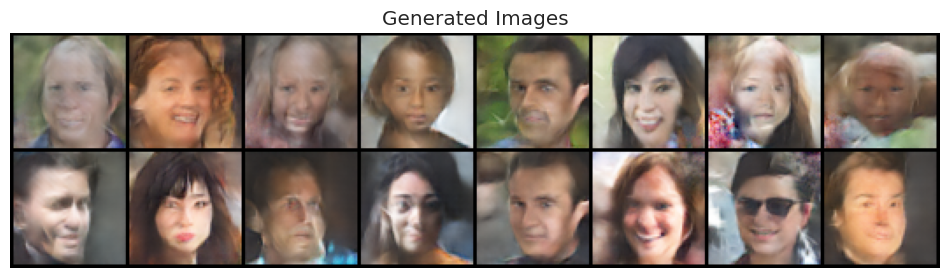

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [72/80], loss_g: 5.2429, loss_d: 0.1150, real_score: 0.9619, fake_score: 0.0381


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [73/80], loss_g: 5.3222, loss_d: 0.1464, real_score: 0.9547, fake_score: 0.0453


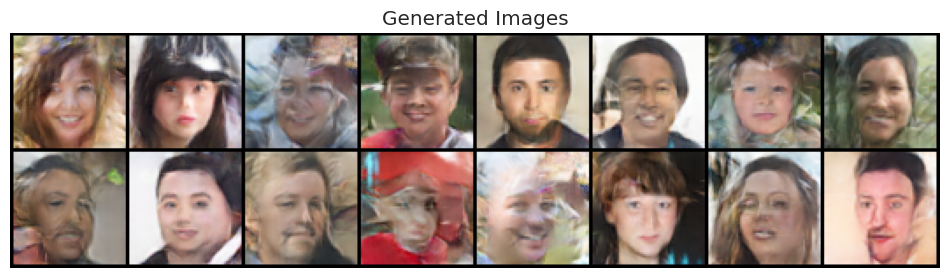

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [74/80], loss_g: 5.2926, loss_d: 0.1917, real_score: 0.9478, fake_score: 0.0521


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [75/80], loss_g: 5.2831, loss_d: 0.0948, real_score: 0.9659, fake_score: 0.0341


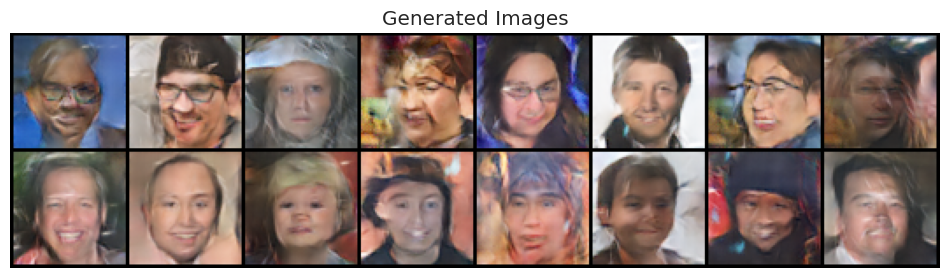

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [76/80], loss_g: 5.1482, loss_d: 0.1665, real_score: 0.9529, fake_score: 0.0473


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [77/80], loss_g: 5.3006, loss_d: 0.2037, real_score: 0.9462, fake_score: 0.0538


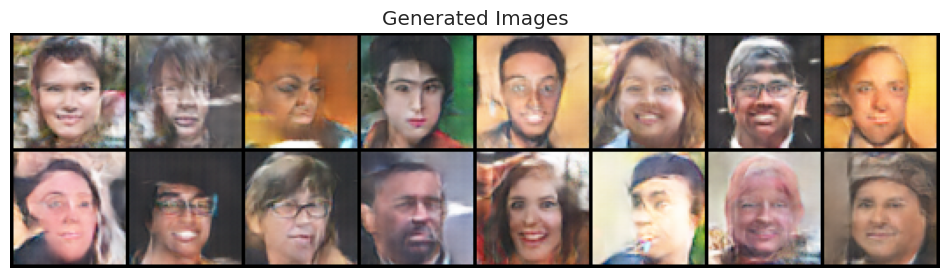

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [78/80], loss_g: 5.2350, loss_d: 0.1042, real_score: 0.9634, fake_score: 0.0366


  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [79/80], loss_g: 5.4102, loss_d: 0.1532, real_score: 0.9566, fake_score: 0.0432


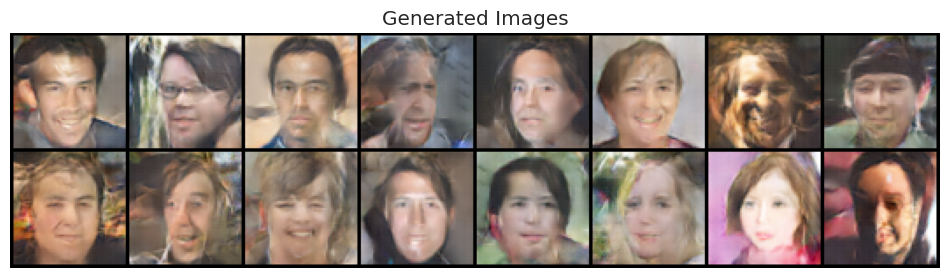

  0%|          | 0/547 [00:00<?, ?it/s]

Epoch [80/80], loss_g: 5.3533, loss_d: 0.1441, real_score: 0.9568, fake_score: 0.0435
Saving generated-images-0080.png


In [23]:
history = fit(model, criterion, epochs, lr)

Постройте графики лосса для генератора и дискриминатора. Что вы можете сказать про эти графики?

In [27]:
losses_g, losses_d, real_scores, fake_scores = history

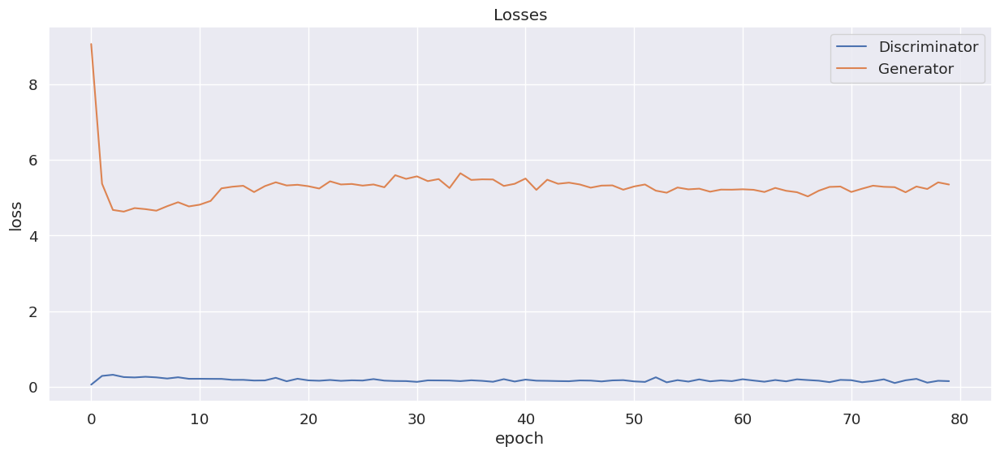

In [28]:
plt.figure(figsize=(15, 6))
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

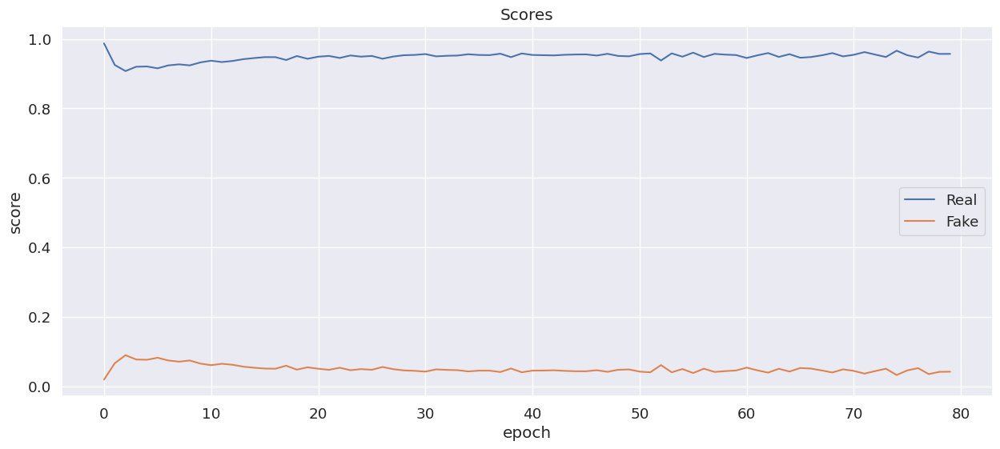

In [29]:
plt.figure(figsize=(15, 6))

plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

## Часть 3. Генерация изображений (1 балл)

Теперь давайте оценим качество получившихся изображений. Напишите функцию, которая выводит изображения, сгенерированные нашим генератором

In [30]:
generated_img = cv2.imread(f'./generated/generated-images-00{epochs}.png')
generated_img = generated_img[:, :, [2, 1, 0]]

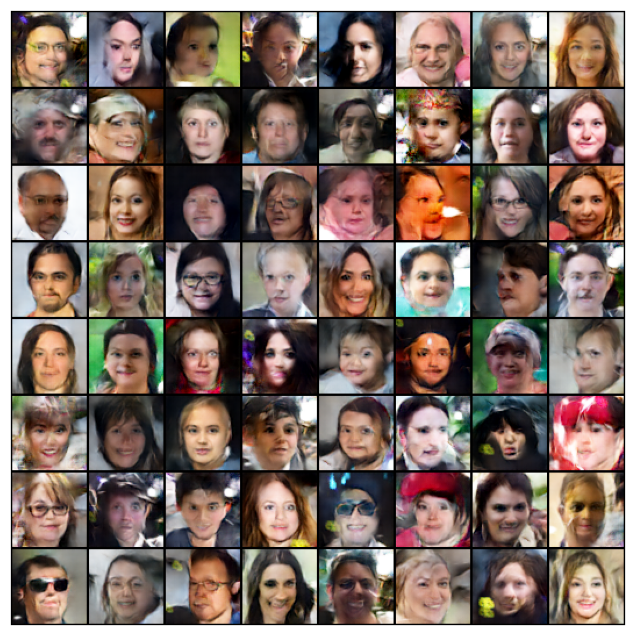

In [31]:
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xticks([]); ax.set_yticks([])
ax.imshow(generated_img)

Как вам качество получившихся изображений?

В приниципе на неокоторые изображения даже похоже на реальные фото,но в общем и целом слишком мыльное получилось конечно,использовал большой датасет и размер 64 потому, что на большом датасете очень долго обучалось. Большой датасет использовал из-за каггла, на колабе кончились часы.

## Часть 4. Leave-one-out-1-NN classifier accuracy (6 баллов)

### 4.1. Подсчет accuracy (4 балла)

Не всегда бывает удобно оценивать качество сгенерированных картинок глазами. В качестве альтернативы вам предлагается реализовать следующий подход:
  * Сгенерировать столько же фейковых изображений, сколько есть настоящих в обучающей выборке. Присвоить фейковым метку класса 0, настоящим – 1.
  * Построить leave-one-out оценку: обучить 1NN Classifier (`sklearn.neighbors.KNeighborsClassifier(n_neighbors=1)`) предсказывать класс на всех объектах, кроме одного, проверить качество (accuracy) на оставшемся объекте. В этом вам поможет `sklearn.model_selection.LeaveOneOut`

In [32]:
n_images = 1000

fixed_latent = torch.randn(n_images, latent_size, 1, 1, device=device)
fake_images = model["generator"].to(device)(fixed_latent)
real_images = next(iter(get_dataloader(64, n_images)))[0]

In [33]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import LeaveOneOut
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

zeros = torch.zeros(n_images, 1, device='cpu')
ones = torch.ones(n_images, 1, device='cpu')

X = torch.cat((fake_images.cpu(), real_images.cpu())).detach().numpy().reshape(-1, 3*64*64)
y = torch.cat((zeros, ones)).detach().numpy()

knc = KNeighborsClassifier(n_neighbors=1)
loo = LeaveOneOut()

accuracy_score_history = []
predictions = []
targets = []
for train_index, test_index in tqdm(loo.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]
    knc.fit(X_train, np.ravel(y_train))
    pred = knc.predict(X_test)
    accuracy_score_history.append(accuracy_score(pred, y_test))
    predictions.append(pred)
    targets.append(y_test)

0it [00:00, ?it/s]

Mean accuracy = 0.6655


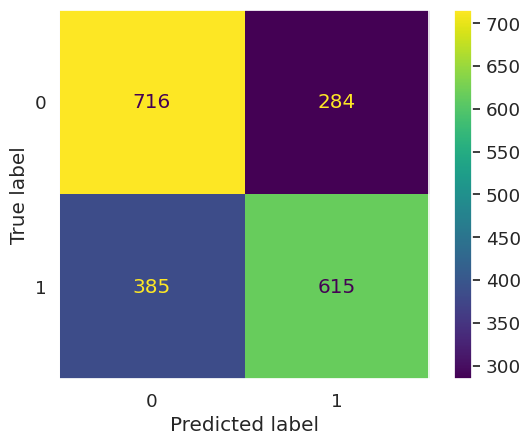

In [34]:
print('Mean accuracy =', np.mean(accuracy_score_history))

cm =  confusion_matrix([t.item() for t in targets],
                       [p.item() for p in predictions])
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

Что вы можете сказать о получившемся результате? Какой accuracy мы хотели бы получить и почему?

### 4.2. Визуализация распределений (2 балла)

Давайте посмотрим на то, насколько похожи распределения настоящих и фейковых изображений. Для этого воспользуйтесь методом, снижающим размерность (к примеру, TSNE) и изобразите на графике разным цветом точки, соответствующие реальным и сгенерированным изображенияи

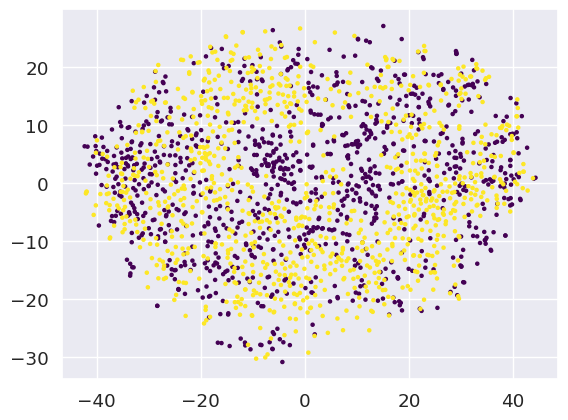

In [35]:
import numpy as np
from sklearn.manifold import TSNE
X_embedded = TSNE(n_components=2, learning_rate='auto',init='random').fit_transform(X)
x1, x2 = zip(*X_embedded)
plt.scatter(x1, x2, c=y, s=5, cmap='viridis')

Прокомментируйте получившийся результат:

Видим что точки перемешаны,но фиолетовые точки все таки немного отделяются группами, что говорит о несовершенности модели
